In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix, mean_squared_error, classification_report
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn import datasets, tree, linear_model
from sklearn.preprocessing import PolynomialFeatures
import seaborn as sns
import operator

#read in datasets
energy = pd.read_csv('../../data/energy_dataset.csv')
weather = pd.read_csv('../../data/weather_features.csv')

#merge datasets
dataset = pd.merge(energy, weather, left_on="time", right_on="dt_iso")

#remove useless columns
dataset = dataset.drop(['temp_max', 'temp_min', 'weather_main', 'weather_description', 'weather_icon'], axis = 1)

In [2]:
Val_weather = weather[weather.city_name == 'Valencia'].copy().reset_index(drop = True)
Sev_weather = weather[weather.city_name ==  'Seville'].copy().reset_index(drop = True)
Mad_weather = weather[weather.city_name ==  'Madrid'].copy().reset_index(drop = True)
Bil_weather = weather[weather.city_name ==  'Bilbao'].copy().reset_index(drop = True)
Bar_weather = weather[weather.city_name ==  ' Barcelona'].copy().reset_index(drop = True)

for i in range(len(energy)):
    if Val_weather.iloc[i]['dt_iso'] != energy.iloc[i]['time']:
        Val_weather.drop(i, axis = 0, inplace = True)
    if Sev_weather.iloc[i]['dt_iso'] != energy.iloc[i]['time']:
        Sev_weather.drop(i, axis = 0, inplace = True)
    if Mad_weather.iloc[i]['dt_iso'] != energy.iloc[i]['time']:
        Mad_weather.drop(i, axis = 0, inplace = True)
    if Bil_weather.iloc[i]['dt_iso'] != energy.iloc[i]['time']:
        Bil_weather.drop(i, axis = 0, inplace = True)
    if Bar_weather.iloc[i]['dt_iso'] != energy.iloc[i]['time']:
        Bar_weather.drop(i, axis = 0, inplace = True)


In [6]:
Valencia = pd.merge(energy, Val_weather, left_on="time", right_on="dt_iso")
Seville = pd.merge(energy, Sev_weather, left_on="time", right_on="dt_iso")
Madrid = pd.merge(energy, Mad_weather, left_on="time", right_on="dt_iso")
Bilbao = pd.merge(energy, Bil_weather, left_on="time", right_on="dt_iso")
Barcelona = pd.merge(energy, Bar_weather, left_on="time", right_on="dt_iso")


In [13]:
average = (pd.concat([Valencia, Seville, Madrid, Bilbao, Barcelona])).groupby(level = 0).mean()

temp vs total load


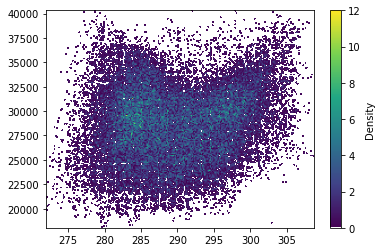

temp vs price


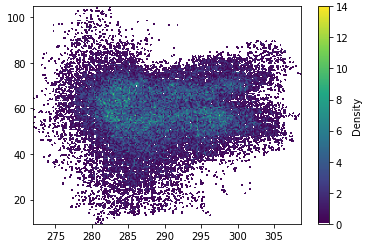

temp vs wind generation


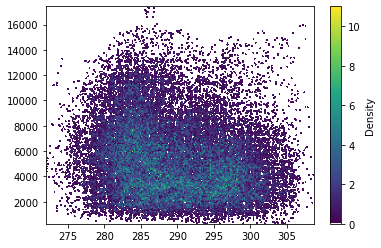

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import mpl_scatter_density
from matplotlib.colors import LinearSegmentedColormap

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

def scatter_density(fig, x, y):
    ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
    density = ax.scatter_density(x, y, cmap=white_viridis)
    fig.colorbar(density, label='Density')

print('temp vs total load')
fig = plt.figure()
scatter_density(fig, average['temp'], average['total load actual'])
plt.show()

print('temp vs price')
fig = plt.figure()
scatter_density(fig, average['temp'], average['price actual'])
plt.show()

print('temp vs wind generation')
fig = plt.figure()
scatter_density(fig, average['temp'], average['generation wind onshore'])
plt.show()

## Polynomial Regression - Temp vs Price

In [18]:
def poly(x, y, degree):
    p = PolynomialFeatures(degree = degree)

    #get testing and training sets
    x_test, x_train, y_test, y_train = train_test_split(x, y, test_size = 0.2)

    #transform testing and training dataset to p sized array
    x_poly_test = p.fit_transform(x_test.values.reshape(-1, 1))
    x_poly_train = p.fit_transform(x_train.values.reshape(-1, 1))

    #create and fit model to dataset
    model = linear_model.LinearRegression()
    model.fit(x_poly_train, y_train)

    #predict models
    y_train_pred = model.predict(x_poly_train)
    y_test_pred = model.predict(x_poly_test)

    #MSEs
    print('Training Mean Squared Error ', mean_squared_error(y_train, y_train_pred))
    print('Testing Mean Squared Error ', mean_squared_error(y_test, y_test_pred))
    print('Training Root Mean Squared Error ', np.sqrt(mean_squared_error(y_train, y_train_pred)))
    print('Testing Root Mean Squared Error ', np.sqrt(mean_squared_error(y_test, y_test_pred)))

    #plotting training data versus predicted data
    fig = plt.figure()
    scatter_density(fig, x, y)
    sort_axis = operator.itemgetter(0)
    sorted_zip = sorted(zip(x_train, y_train_pred), key = sort_axis)
    x_poly_train, y_train_pred = zip(*sorted_zip)
    plt.plot(x_poly_train, y_train_pred, 'r')
    plt.show()

    return model, x_train, x_test, y_train, y_test

Training Mean Squared Error  173.5745615257839
Testing Mean Squared Error  170.08782419622986
Training Root Mean Squared Error  13.174769885116929
Testing Root Mean Squared Error  13.041772279726013


/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


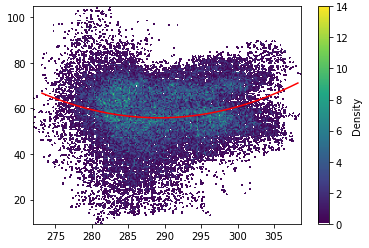

In [20]:
temp_price_d2 = poly(average['temp'], average['price actual'], 2)

Training Mean Squared Error  164.54353048012655
Testing Mean Squared Error  171.76186245128295
Training Root Mean Squared Error  12.827452220925501
Testing Root Mean Squared Error  13.105794995012053


/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


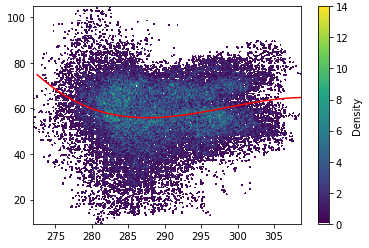

In [21]:
temp_price_d3 = poly(average['temp'], average['price actual'], 3)

Training Mean Squared Error  170.9401642202323
Testing Mean Squared Error  169.34097817823172
Training Root Mean Squared Error  13.074408752224029
Testing Root Mean Squared Error  13.013107936931581


/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


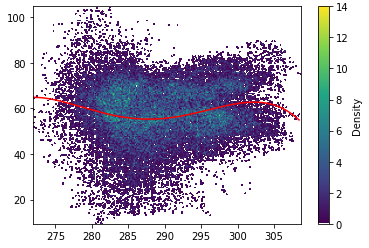

In [22]:
temp_price_d4 = poly(average['temp'], average['price actual'], 4)

## Polynomial Regression - Temp vs Wind

Training Mean Squared Error  7938691.938455063
Testing Mean Squared Error  8453842.840477109
Training Root Mean Squared Error  2817.5684443248338
Testing Root Mean Squared Error  2907.549284273116


/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


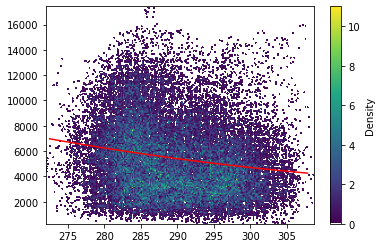

In [27]:
temp_wind = pd.DataFrame({'wind': average['generation wind onshore'], 'temp': average['temp']}).dropna()
temp_wind_d2 = poly(temp_wind['temp'], temp_wind['wind'], 2)

Training Mean Squared Error  8333733.452712701
Testing Mean Squared Error  8294122.681305007
Training Root Mean Squared Error  2886.820647825684
Testing Root Mean Squared Error  2879.951853990793


/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


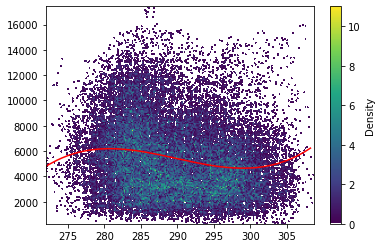

In [28]:
temp_wind = pd.DataFrame({'wind': average['generation wind onshore'], 'temp': average['temp']}).dropna()
temp_wind_d3 = poly(temp_wind['temp'], temp_wind['wind'], 3)

## Polynomial Regression - Temp vs Load

Training Mean Squared Error  13675618.814441938
Testing Mean Squared Error  13354300.99291469
Training Root Mean Squared Error  3698.0560858972835
Testing Root Mean Squared Error  3654.3537038599165


/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


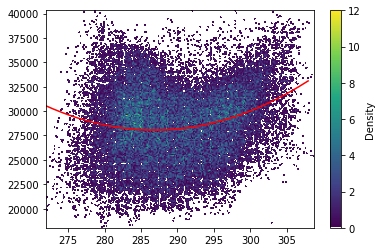

In [29]:
temp_load = pd.DataFrame({'load': average['total load actual'], 'temp': average['temp']}).dropna()
temp_load_d2 = poly(temp_load['temp'], temp_load['load'], 2)

Training Mean Squared Error  12879443.17121832
Testing Mean Squared Error  13201525.33842724
Training Root Mean Squared Error  3588.794111009758
Testing Root Mean Squared Error  3633.3903366452714


/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


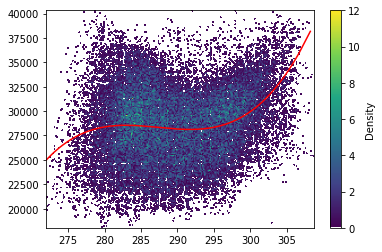

In [30]:
temp_load = pd.DataFrame({'load': average['total load actual'], 'temp': average['temp']}).dropna()
temp_load_d3 = poly(temp_load['temp'], temp_load['load'], 3)

Training Mean Squared Error  12881179.180139642
Testing Mean Squared Error  13017155.288476776
Training Root Mean Squared Error  3589.0359680755
Testing Root Mean Squared Error  3607.9295015946163


/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/home/claire/.local/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


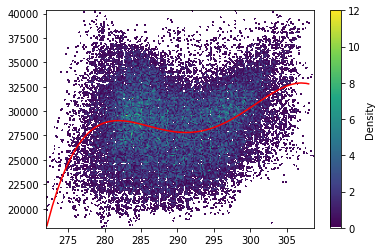

In [31]:
temp_load = pd.DataFrame({'load': average['total load actual'], 'temp': average['temp']}).dropna()
temp_load_d4 = poly(temp_load['temp'], temp_load['load'], 4)

In [45]:
#split energy columns into separate datasets for easier viewing
def split(city, col_name, dataset):
    for i in energy.columns:
        if i != col_name:
            dataset = dataset.drop(i, axis = 1)
    get_plots(city, col_name, dataset)
    return dataset

def heatmap(city, col_name, dataset):
    fig, ax = plt.subplots(figsize = (20, 20))
    sns.heatmap(dataset.corr(), annot = True, vmin = -1, vmax = 1, ax = ax)
    fig.savefig('/home/claire/Documents/ECS171/%s/%s_%s_heatmap.png' %(city, city, col_name.replace('/', ' ')))
    plt.show()

def pairplot(city, col_name, dataset):
    sns.pairplot(dataset, y_vars = [col_name])#, hue = 'weather_id')
    plt.savefig('/home/claire/Documents/ECS171/%s/%s_%s_pairplot.png' %(city, city, col_name.replace('/', ' ')))
    
def get_plots(city, col_name, dataset):
    heatmap(city, col_name, dataset)
    pairplot(city, col_name, dataset)

def analyze(city, dataset):
    biomass = split(city, 'generation biomass', dataset)
    lignite = split(city, 'generation fossil brown coal/lignite', dataset)
    coal = split(city, 'generation fossil hard coal', dataset)
    oil = split(city, 'generation fossil oil', dataset)
    shale_oil = split(city, 'generation fossil oil shale', dataset)
    peat = split(city, 'generation fossil peat', dataset)
    geothermal = split(city, 'generation geothermal', dataset)
    hydropump_storage_tot = split(city, 'generation hydro pumped storage aggregated', dataset)
    hydropump_storage_cons = split(city, 'generation hydro pumped storage consumption', dataset)
    hydro_river = split(city, 'generation hydro run-of-river and poundage', dataset)
    water_rsv = split(city, 'generation hydro water reservoir', dataset)
    marine = split(city, 'generation marine', dataset)
    nuclear = split(city, 'generation nuclear', dataset)
    other = split(city, 'generation other', dataset)
    other_renew = split(city, 'generation other renewable', dataset)
    solar = split(city, 'generation solar', dataset)
    waste = split(city, 'generation waste', dataset)
    offshore_wind = split(city, 'generation wind offshore', dataset)
    onshore_wind = split(city, 'generation wind onshore', dataset)
    forecasted_solar = split(city, 'forecast solar day ahead', dataset)
    forecasted_offshore_wind = split(city, 'forecast wind offshore eday ahead', dataset)
    forecasted_onshore_wind = split(city, 'forecast wind onshore day ahead', dataset)
    forecasted_load = split(city, 'total load forecast', dataset)
    total_load = split(city, 'total load actual', dataset)
    predicted_price = split(city, 'price day ahead', dataset)
    price = split(city, 'price actual', dataset)

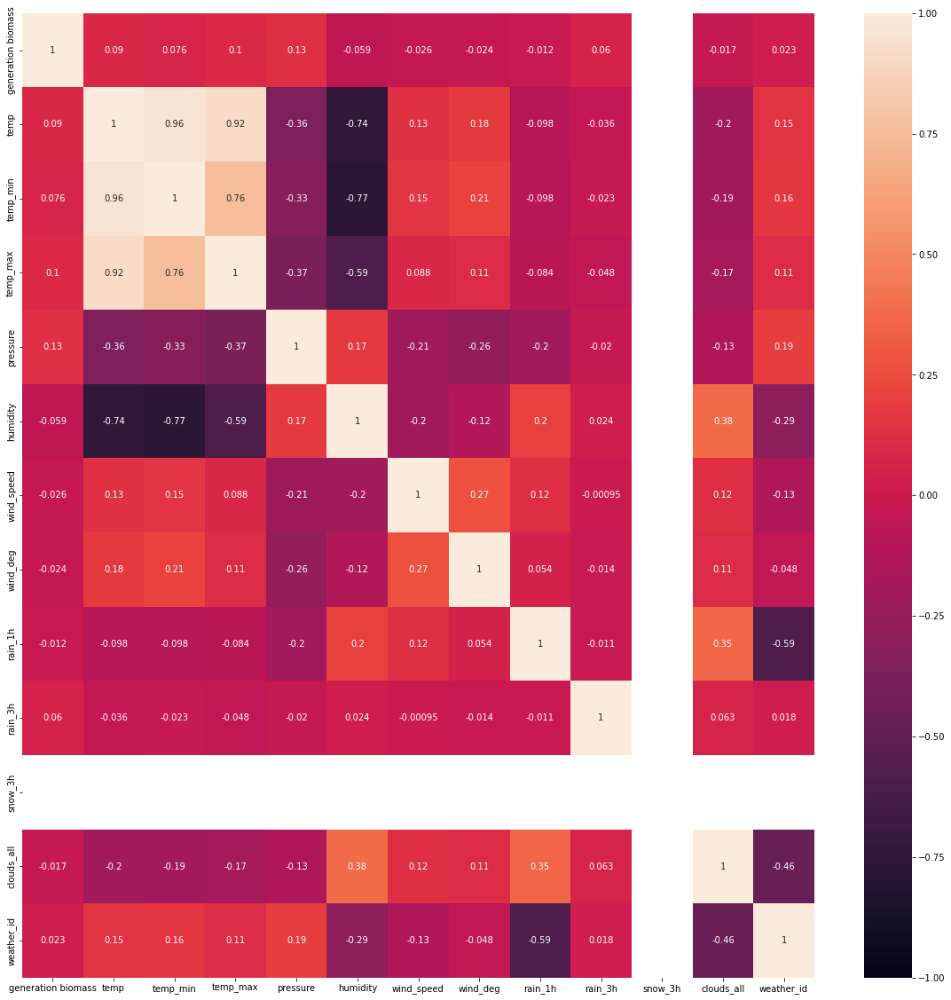

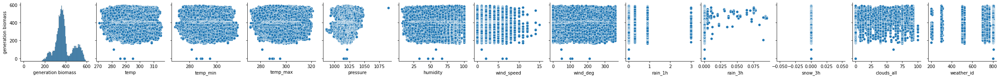

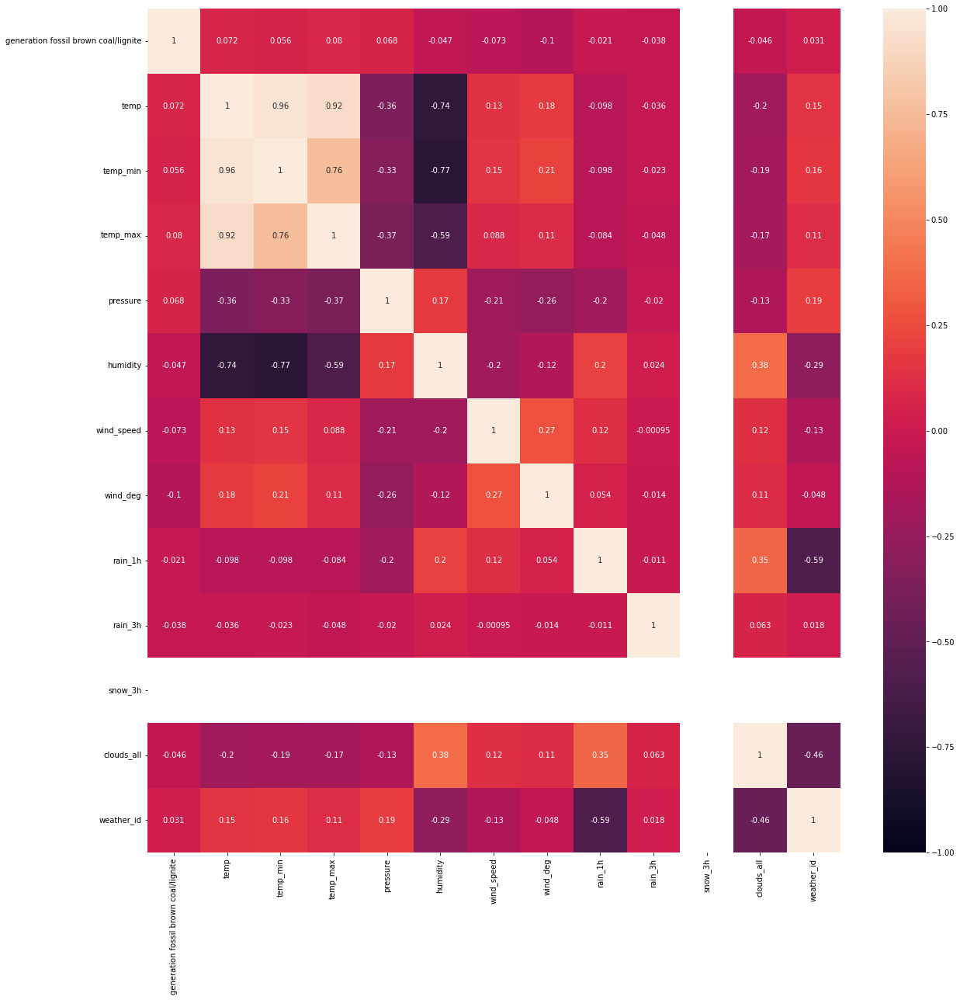

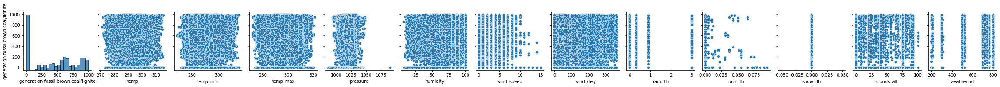

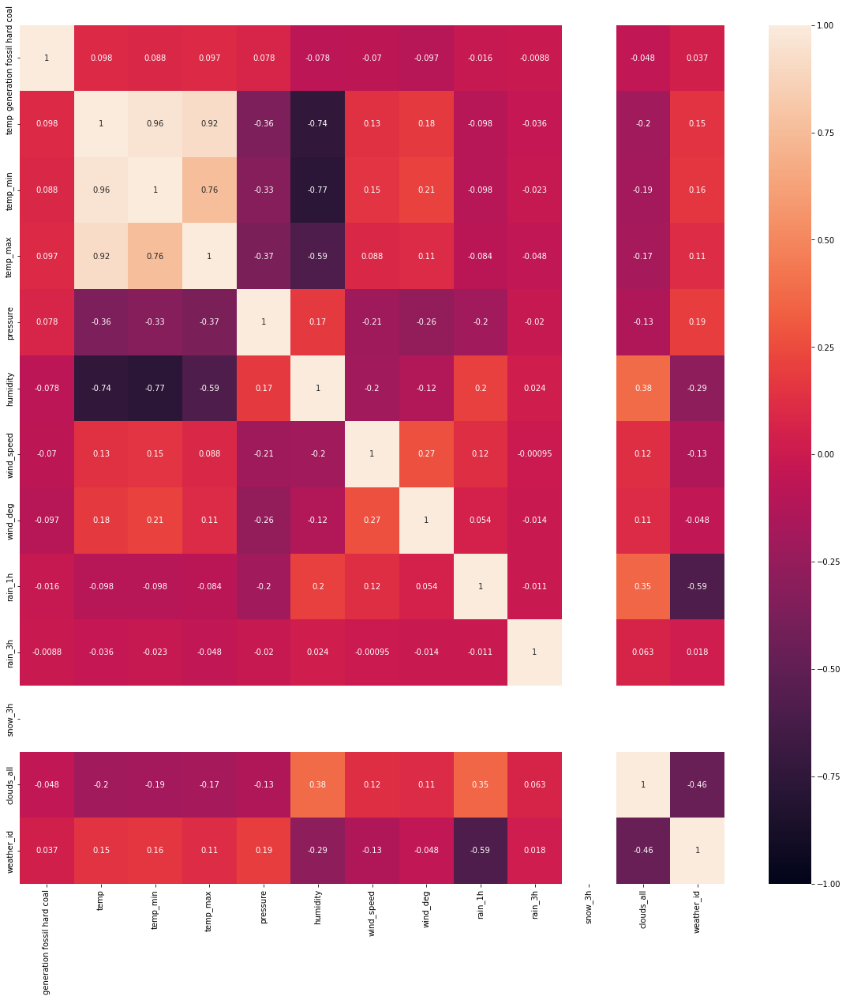

...

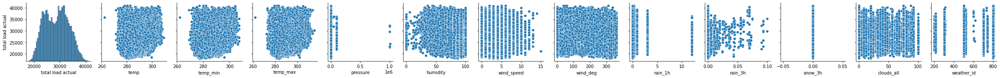

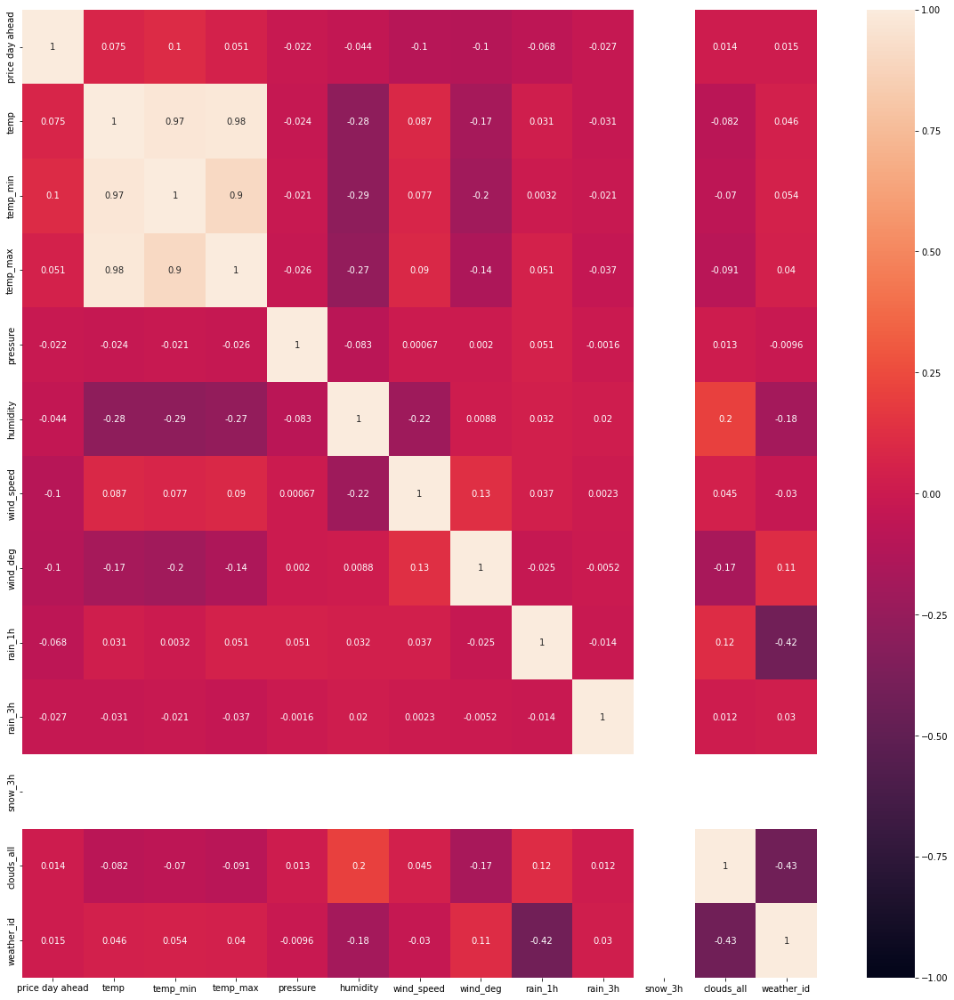

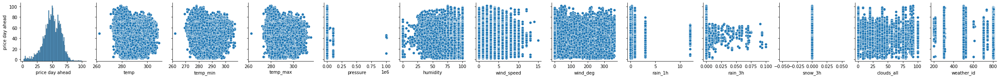

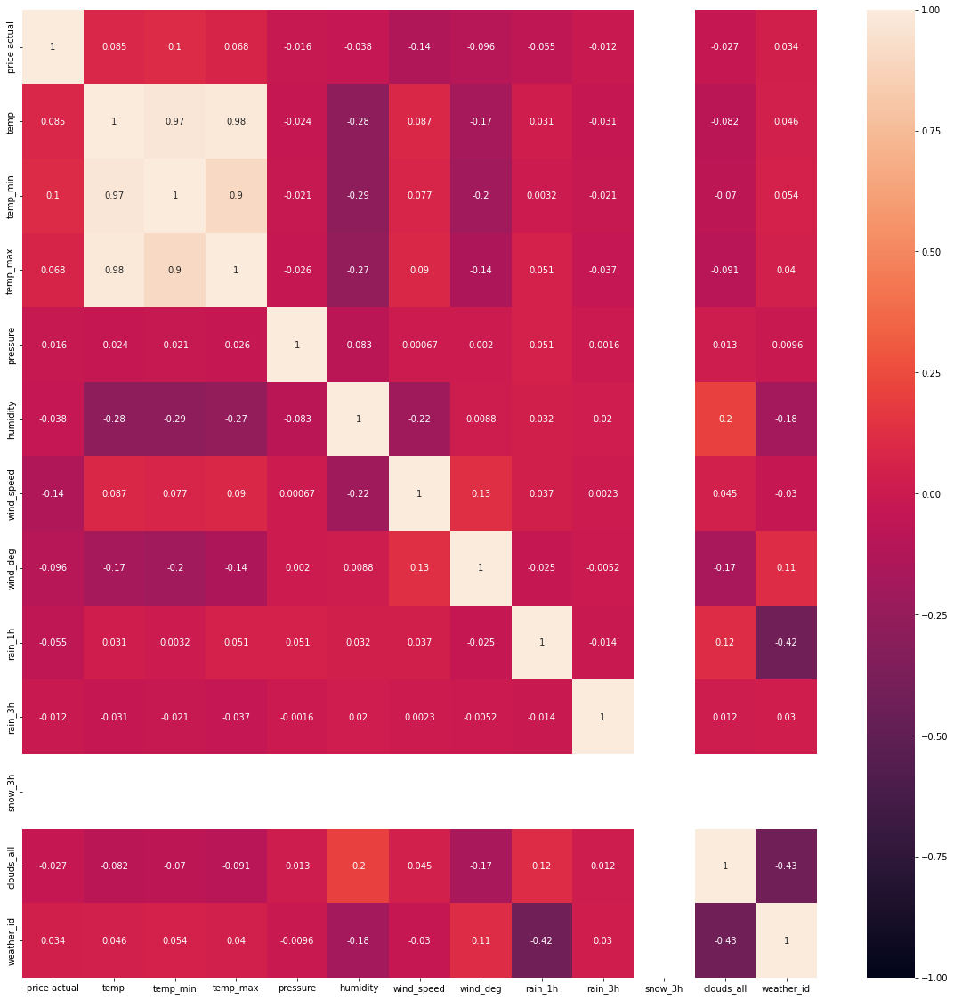

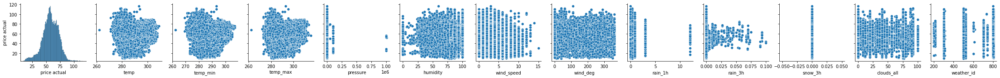

In [49]:
#analyze('Valencia', Valencia)
analyze('Seville', Seville)
analyze('Madrid', Madrid)
analyze('Bilbao', Bilbao)
analyze('Barcelona', Barcelona)